<a href="https://colab.research.google.com/github/ashish807/Social-Distancing-App/blob/master/Face_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/gdrive')


Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /gdrive


In [ ]:
!pip install face_recognition


     |████████████████████████████████| 100.2MB 42kB/s 
  Created wheel for face-recognition-models: filename=face_recognition_models-0.3.0-py2.py3-none-any.whl size=100566173 sha256=a745c886b3f2f8b9e565bcb152073deca2c621778234d54d157d7ab8d7845664
  Stored in directory: /root/.cache/pip/wheels/d2/99/18/59c6c8f01e39810415c0e63f5bede7d83dfb0ffc039865465f
Successfully built face-recognition-models


In [ ]:
import face_recognition
import os
import cv2
from google.colab.patches import cv2_imshow

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
KNOWN_FACE_DIR = "/content/drive/My Drive/known_faces"
UNKNOWN_FACE_DIR = "/content/drive/My Drive/unknown_face"
TOLERANCE =0.55

In [ ]:
FRAME_THICKNESS = 3
FONT_THICKNESS =2
MODEL = "cnn"

In [ ]:
print("loading Known faces")

known_faces = []
known_names=  []

for name in os.listdir(KNOWN_FACE_DIR):
    image = face_recognition.load_image_file(f"{KNOWN_FACE_DIR}/{name}")
    encoding = face_recognition.face_encodings(image)[0]

    known_faces.append(encoding)
    known_names.append(name)
    
    
print(known_names)




loading Known faces
['Elon Musk.jpg', 'Donald Trump.jpg', 'Joe Biden.jpg', 'Barack Obama.jpg', 'Ashish.jpg']


Processing unknown faces
72a685259dc4d0e210272274a2c3e2c0.jpg
Match found: Elon Musk.jpg


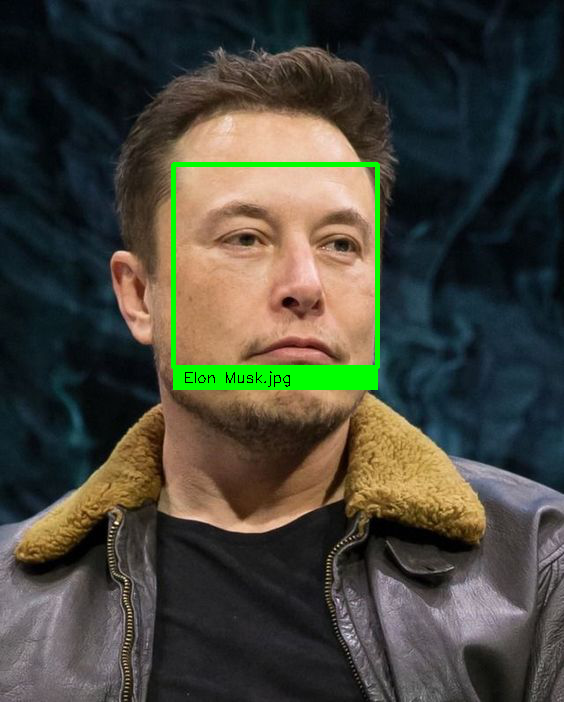

72a685259dc4d0e210272274a2c3e2c0.jpg
Biz-musk-AP_19338608014367.jpg
Match found: Elon Musk.jpg


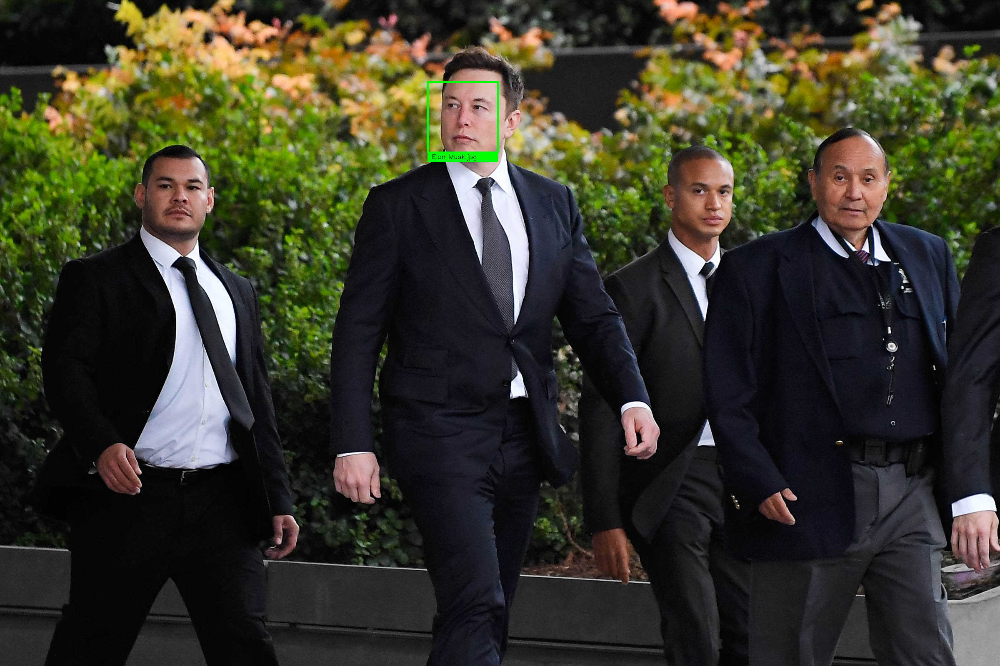

Biz-musk-AP_19338608014367.jpg
140423-shanghai-april-23-2014-xinhua-elon-musk-1st-r-ceo-of-american-DYNG65.jpg
Match found: Elon Musk.jpg


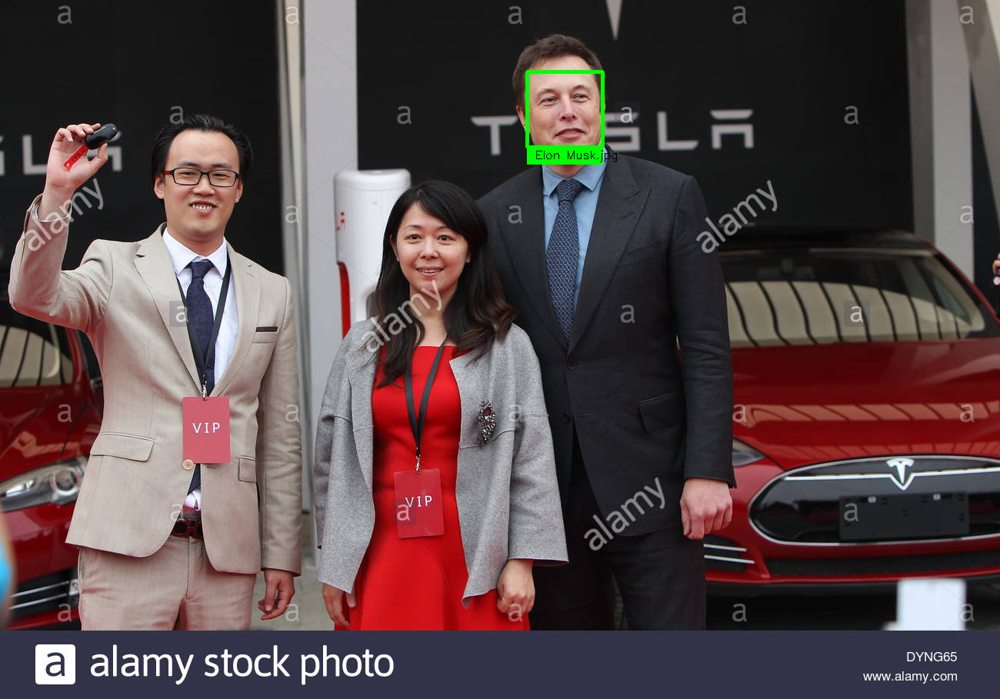

140423-shanghai-april-23-2014-xinhua-elon-musk-1st-r-ceo-of-american-DYNG65.jpg
06musk-mobileMasterAt3x.jpg
Match found: Elon Musk.jpg


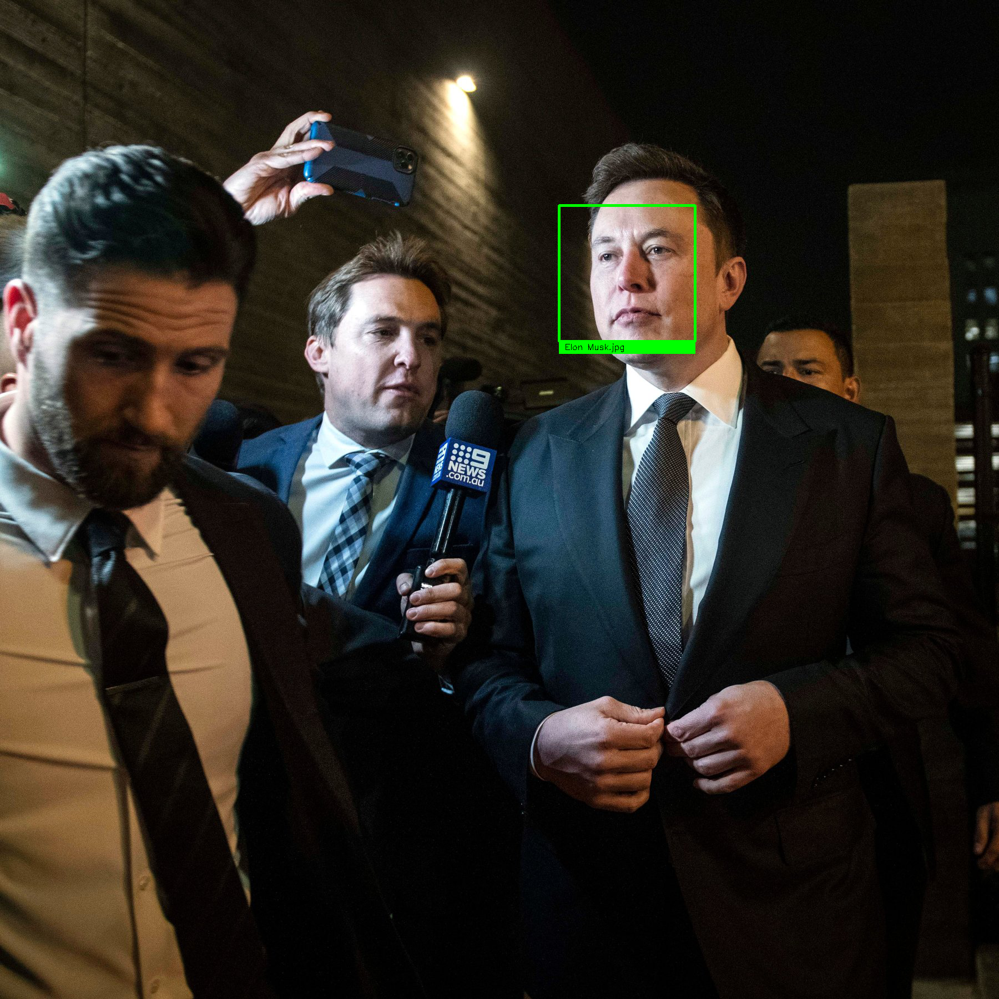

06musk-mobileMasterAt3x.jpg
Nohra-group-photo-Obama-Goldman-winners.jpeg
Match found: Barack Obama.jpg


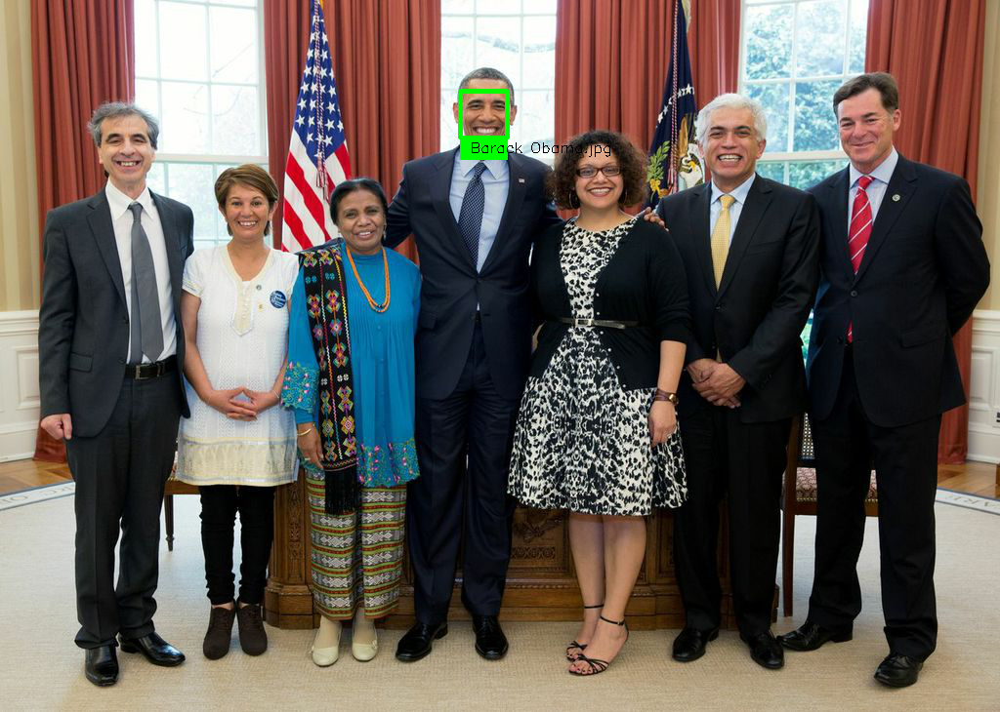

Nohra-group-photo-Obama-Goldman-winners.jpeg
Obama.jpg
Match found: Barack Obama.jpg
Match found: Joe Biden.jpg


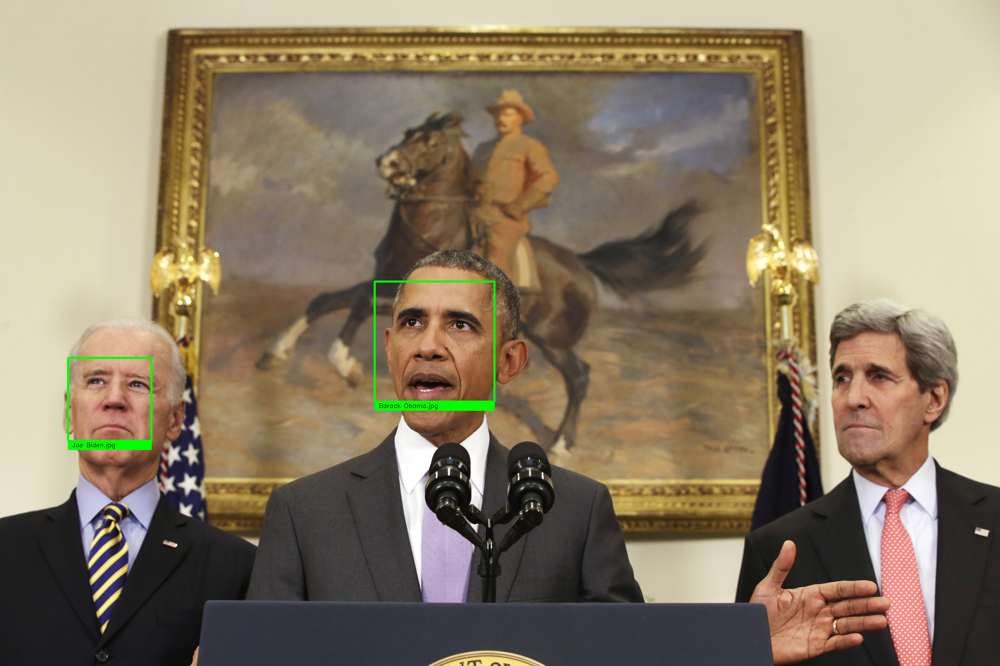

Obama.jpg
Obama-Biden-not-a-meme.jpg
Match found: Joe Biden.jpg
Match found: Barack Obama.jpg


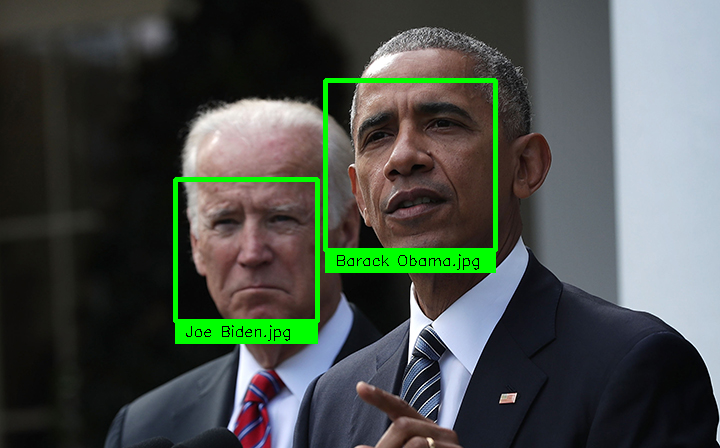

Obama-Biden-not-a-meme.jpg
obama_photoop_092111.jpg
Match found: Barack Obama.jpg


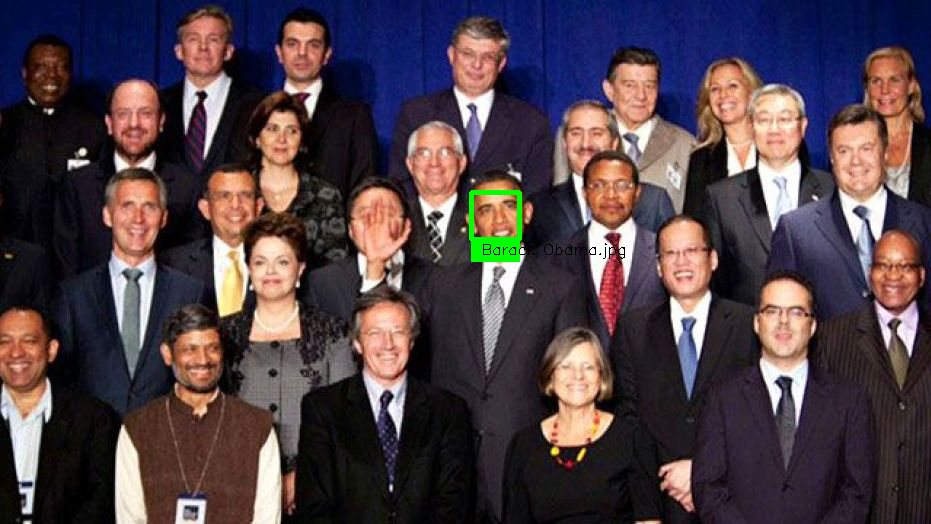

obama_photoop_092111.jpg
TELEMMGLPICT000135638612_trans_NvBQzQNjv4BqpVlberWd9EgFPZtcLiMQfyf2A9a6I9YchsjMeADBa08.webp
Match found: Donald Trump.jpg


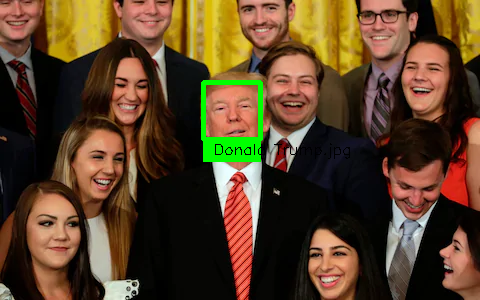

TELEMMGLPICT000135638612_trans_NvBQzQNjv4BqpVlberWd9EgFPZtcLiMQfyf2A9a6I9YchsjMeADBa08.webp
trump-jack-ma-ap_17009620904165.jpg
Match found: Donald Trump.jpg


In [ ]:
print("Processing unknown faces")



for filename in os.listdir(UNKNOWN_FACE_DIR):
  print(filename)
  image =face_recognition.load_image_file(f"{UNKNOWN_FACE_DIR}/{filename}")
  locations = face_recognition.face_locations(image,model=MODEL)
  encoding = face_recognition.face_encodings(image, locations)
  image = cv2.cvtColor(image,cv2.COLOR_RGB2BGR)

  for face_encoding, face_location in zip(encoding, locations):
    results= face_recognition.compare_faces(known_faces, face_encoding,TOLERANCE) #List of boolean
    match =None
    if True in results:
      match = known_names[results.index(True)]
      print(f"Match found: {match}")


      top_left = (face_location[3], face_location[0])
      bottom_right = (face_location[1], face_location[2])

      color =[0,255,0]

      cv2.rectangle(image, top_left,bottom_right,color, FRAME_THICKNESS)
      top_left = (face_location[3], face_location[2])
      bottom_right = (face_location[1], face_location[2]+22)
      cv2.rectangle(image, top_left,bottom_right,color, cv2.FILLED)
      cv2.putText(image, match, (face_location[3]+10,face_location[2]+15), cv2.FONT_HERSHEY_SIMPLEX, 0.5, FONT_THICKNESS)
  cv2_imshow(image)
  print(filename)


In [ ]:
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});
      //stream = face_extractor(stream)
      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

<IPython.core.display.Javascript object>

Saved to photo.jpg


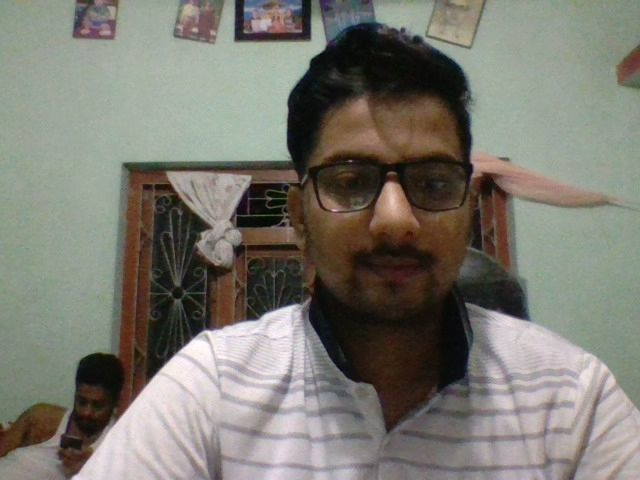

In [ ]:
from IPython.display import Image
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

Processing real time faces
Match found: Ashish.jpg


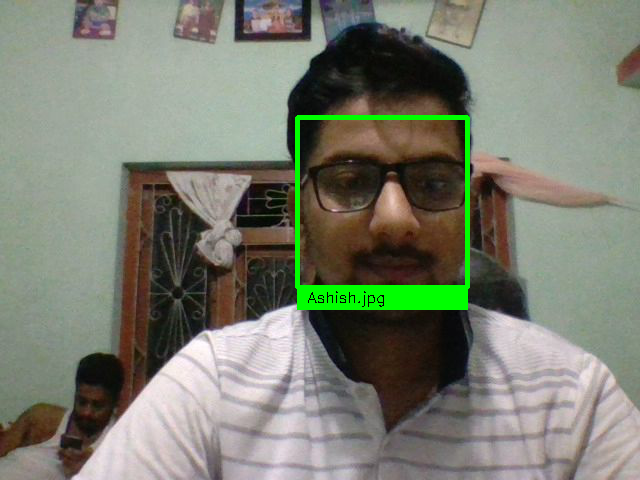

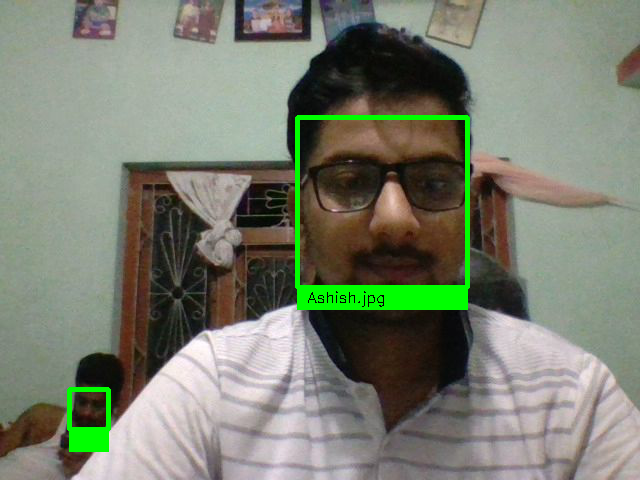

photo.jpg


In [ ]:
print("Processing real time faces")




image =face_recognition.load_image_file("/content/photo.jpg")
locations = face_recognition.face_locations(image,model=MODEL)
encoding = face_recognition.face_encodings(image, locations)
image = cv2.cvtColor(image,cv2.COLOR_RGB2BGR)

for face_encoding, face_location in zip(encoding, locations):
  results= face_recognition.compare_faces(known_faces, face_encoding,TOLERANCE) #List of boolean
  match =None
  if True in results:
    match = known_names[results.index(True)]
    print(f"Match found: {match}")


  top_left = (face_location[3], face_location[0])
  bottom_right = (face_location[1], face_location[2])

  color =[0,255,0]

  cv2.rectangle(image, top_left,bottom_right,color, FRAME_THICKNESS)
  top_left = (face_location[3], face_location[2])
  bottom_right = (face_location[1], face_location[2]+22)
  cv2.rectangle(image, top_left,bottom_right,color, cv2.FILLED)
  cv2.putText(image, match, (face_location[3]+10,face_location[2]+15), cv2.FONT_HERSHEY_SIMPLEX, 0.5, FONT_THICKNESS)
  cv2_imshow(image)
print(filename)
